In [2]:
import numpy as np
import os
from skimage import io

# Function to load images and extract color channels
def load_and_extract_organs(image_folder):
    # List all files in the folder and sort them
    image_files = sorted([f for f in os.listdir(image_folder) if f.endswith('.png')])

    # Initialize lists to hold the organ data
    organ1, organ2, organ3 = [], [], []

    # Load each image
    for filename in image_files:
        image_path = os.path.join(image_folder, filename)
        image = io.imread(image_path)
        
        # Assuming red channel for organ1, green for organ2, blue for organ3
        organ1.append(image[:, :, 0])
        organ2.append(image[:, :, 1])
        organ3.append(image[:, :, 2])

    # Stack the images to form 3D volumes
    volume1 = np.stack(organ1, axis=-1)
    volume2 = np.stack(organ2, axis=-1)
    volume3 = np.stack(organ3, axis=-1)

    return volume1, volume2, volume3

def plot_3d(volume, threshold=50):
    # Position the scan upright, so the head of the patient would be on the top
    p = volume.transpose(2, 1, 0)
    p = p[:, :, ::-1]

    # A higher threshold indicates that the algorithm will render a denser part of the scan
    verts, faces, _, _ = measure.marching_cubes(p, threshold)

    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], alpha=0.70)
    face_color = [0.45, 0.45, 0.75]  # Change face color here if needed
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])

    plt.show()

# Usage
image_folder = '/Users/Tina/Desktop/Labels' # Replace with your folder path
volume1, volume2, volume3 = load_and_extract_organs(image_folder)

In [2]:
!pip install scikit-image

  Using cached scikit_image-0.23.1-cp311-cp311-macosx_12_0_arm64.whl.metadata (14 kB)
  Using cached networkx-3.3-py3-none-any.whl.metadata (5.1 kB)
  Using cached imageio-2.34.0-py3-none-any.whl.metadata (4.9 kB)
  Using cached lazy_loader-0.4-py3-none-any.whl.metadata (7.6 kB)
Using cached scikit_image-0.23.1-cp311-cp311-macosx_12_0_arm64.whl (13.3 MB)
Using cached imageio-2.34.0-py3-none-any.whl (313 kB)
Using cached lazy_loader-0.4-py3-none-any.whl (12 kB)
Using cached networkx-3.3-py3-none-any.whl (1.7 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 225.0/225.0 kB 4.4 MB/s eta 0:00:005.7 MB/s eta 0:00:01


In [3]:
import os
from skimage.io import imread, imsave
from skimage.transform import resize
from skimage import img_as_ubyte

# Function to resize images in a folder
def resize_images_in_folder(input_folder, output_folder, target_size):
    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Get list of files in the input folder
    files = os.listdir(input_folder)

    # Resize each image and save it to the output folder
    for file in files:
        # Skip any non-image files (such as .DS_Store)
        if not file.endswith(('.jpg', '.png', '.jpeg')):
            continue

        input_path = os.path.join(input_folder, file)
        output_path = os.path.join(output_folder, file)

        # Load the image
        image = imread(input_path)

        # Resize the image
        resized_image = resize(image, output_shape=target_size)

       # Convert the image array to unsigned 8-bit integer format
        resized_image = img_as_ubyte(resized_image)

        # Save the resized image
        imsave(output_path, resized_image)

# Example usage:
input_folder = '/Users/Tina/Desktop/Labels'
output_folder = '/Users/Tina/Desktop/Resized'
target_size = (266, 266)  # Specify the target size for resizing

resize_images_in_folder(input_folder, output_folder, target_size)


/var/folders/z7/mn3959tx11dfxt1ltnsbc_yw0000gn/T/ipykernel_11354/2759236820.py:34: UserWarning: /Users/Tina/Desktop/Resized/case20_day0_077.png is a low contrast image
  imsave(output_path, resized_image)
/var/folders/z7/mn3959tx11dfxt1ltnsbc_yw0000gn/T/ipykernel_11354/2759236820.py:34: UserWarning: /Users/Tina/Desktop/Resized/case20_day0_063.png is a low contrast image
  imsave(output_path, resized_image)
/var/folders/z7/mn3959tx11dfxt1ltnsbc_yw0000gn/T/ipykernel_11354/2759236820.py:34: UserWarning: /Users/Tina/Desktop/Resized/case20_day0_103.png is a low contrast image
  imsave(output_path, resized_image)
/var/folders/z7/mn3959tx11dfxt1ltnsbc_yw0000gn/T/ipykernel_11354/2759236820.py:34: UserWarning: /Users/Tina/Desktop/Resized/case20_day0_117.png is a low contrast image
  imsave(output_path, resized_image)
/var/folders/z7/mn3959tx11dfxt1ltnsbc_yw0000gn/T/ipykernel_11354/2759236820.py:34: UserWarning: /Users/Tina/Desktop/Resized/case20_day0_116.png is a low contrast image
  imsave(out

In [4]:
import os
from skimage.io import imread

# Folder containing the images
folder_path = '/Users/Tina/Desktop/Resized'

# Filename of the image you want to inspect
image_filename = 'case20_day0_000.png'  # Replace 'image_filename.jpg' with the actual filename

# Construct the full path to the image file
image_path = os.path.join(folder_path, image_filename)

# Load the image
image = imread(image_path)

# Print the shape of the image
print(f"Shape of {image_filename}: {image.shape}")


Shape of case20_day0_000.png: (266, 266, 3)


In [5]:
!pip install scikit-image

In [6]:
pip install numpy matplotlib Pillow

Note: you may need to restart the kernel to use updated packages.


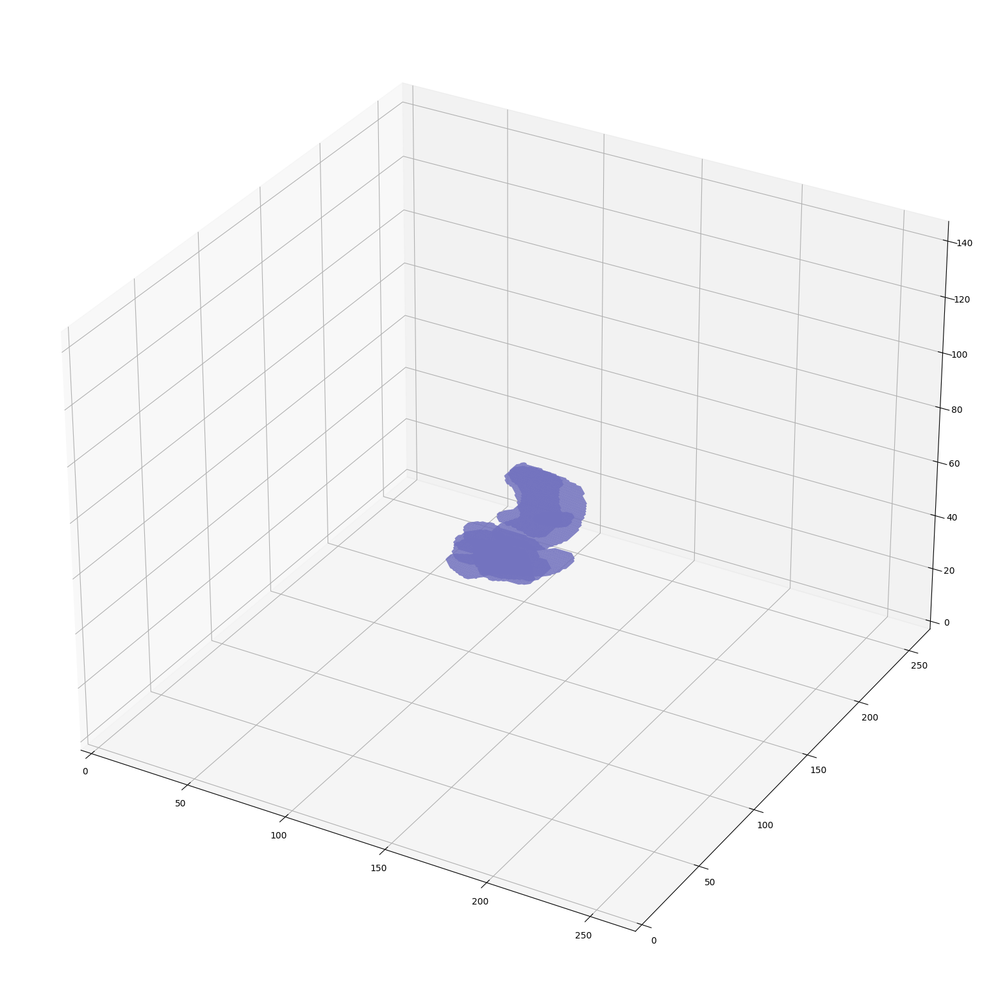

In [7]:
import numpy as np
import os
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage import measure
from PIL import Image

# Function to load images from a given folder
def load_images_from_folder(folder):
    images = []
    for filename in sorted(os.listdir(folder)):
        if filename.endswith('.png'):
            img = Image.open(os.path.join(folder, filename))
            if img is not None:
                images.append(img)
    return images

# Function to extract the color channels into separate 3D volumes
def extract_organ_masks(images):
    organ1_volumes = []
    organ2_volumes = []
    organ3_volumes = []

    for img in images:
        organ1_mask = np.array(img)[:, :, 0]  # Red channel
        organ2_mask = np.array(img)[:, :, 1]  # Green channel
        organ3_mask = np.array(img)[:, :, 2]  # Blue channel

        organ1_volumes.append(organ1_mask)
        organ2_volumes.append(organ2_mask)
        organ3_volumes.append(organ3_mask)
        
    return np.array(organ1_volumes), np.array(organ2_volumes), np.array(organ3_volumes)

# Function to plot a 3D volume using the marching cubes algorithm
def plot_3d(volume, threshold=50):
    # Position the scan upright
    p = volume.transpose(2, 1, 0)
    p = p[:, :, ::-1]

    verts, faces, _, _ = measure.marching_cubes(p, threshold)

    fig = plt.figure(figsize=(20, 20))
    ax = fig.add_subplot(111, projection='3d')

    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], alpha=0.70)
    face_color = [0.45, 0.45, 0.75]  # Change face color here if needed
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])

    plt.show()

# Set the folder where your images are stored
image_folder = '/Users/Tina/Desktop/Resized'  # replace with the path to your image folder
images = load_images_from_folder(image_folder)

# Extract the organ masks into separate 3D volumes
organ1, organ2, organ3 = extract_organ_masks(images)

# Plot the 3D volume for one of the organs
# You can call this function once for each organ you want to visualize
# You might need to adjust the threshold based on your data
plot_3d(organ1, threshold=50)


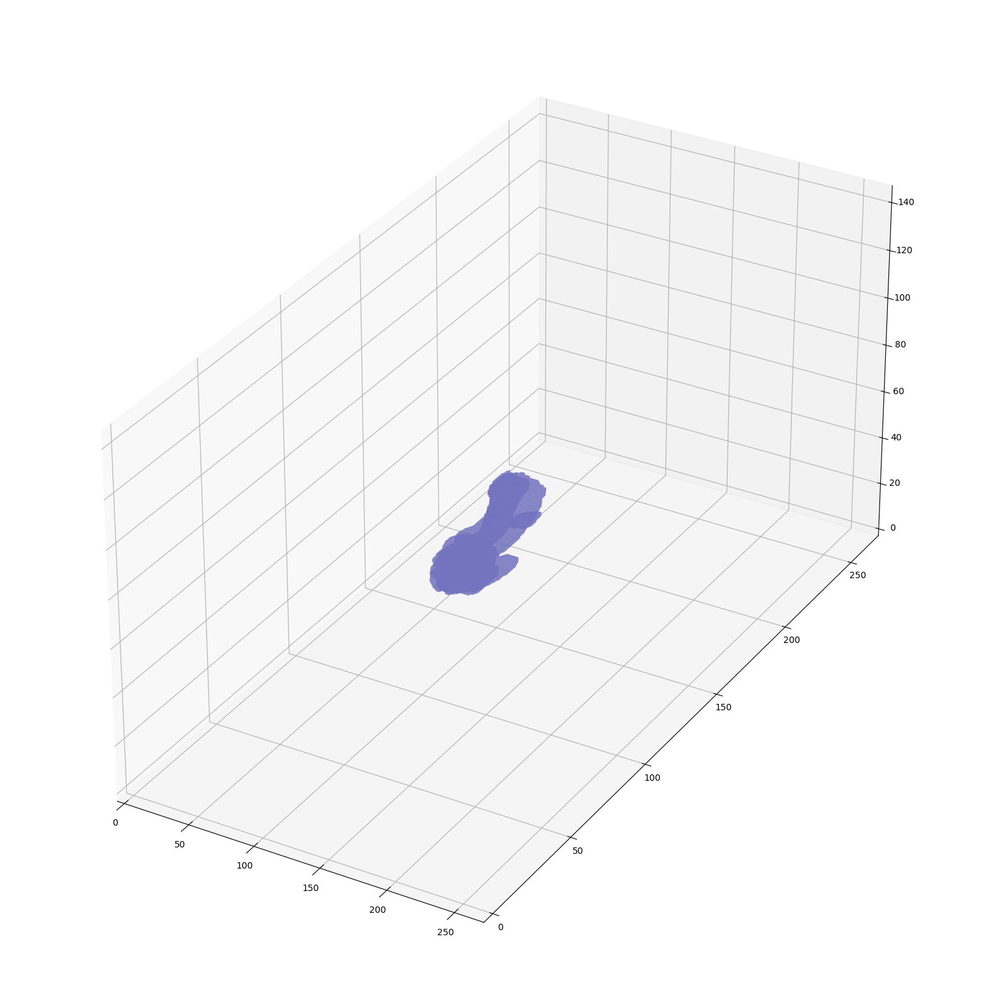

In [8]:
import numpy as np
import os
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage import measure
from PIL import Image

# Function to load images from a given folder
def load_images_from_folder(folder):
    images = []
    if not os.path.exists(folder):
        print("The specified folder does not exist.")
        return images
    for filename in sorted(os.listdir(folder)):
        if filename.endswith('.png'):
            img_path = os.path.join(folder, filename)
            try:
                with Image.open(img_path) as img:
                    images.append(img.copy())
            except IOError:
                print(f"Failed to load {filename}.")
    return images

# Function to extract the color channels into separate 3D volumes
def extract_organ_masks(images):
    organ1_volumes = []
    organ2_volumes = []
    organ3_volumes = []

    for img in images:
        organ1_mask = np.array(img)[:, :, 0]  # Red channel
        organ2_mask = np.array(img)[:, :, 1]  # Green channel
        organ3_mask = np.array(img)[:, :, 2]  # Blue channel

        organ1_volumes.append(organ1_mask)
        organ2_volumes.append(organ2_mask)
        organ3_volumes.append(organ3_mask)
        
    return np.array(organ1_volumes), np.array(organ2_volumes), np.array(organ3_volumes)

# Function to plot a 3D volume using the marching cubes algorithm
def plot_3d(volume, threshold=50, scale_y=1):
    # Position the scan upright and adjust for the specified Y scaling
    p = volume.transpose(2, 1, 0)
    p = p[:, :, ::-1]

    verts, faces, _, _ = measure.marching_cubes(p, threshold)
    fig = plt.figure(figsize=(20, 20))
    ax = fig.add_subplot(111, projection='3d')
    mesh = Poly3DCollection(verts[faces], alpha=0.70)
    face_color = [0.45, 0.45, 0.75]  # Can be adjusted for different organs if needed
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_box_aspect([1, scale_y, 1])  # Scale the Y-axis
    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])
    plt.show()

# Set the folder where your images are stored
image_folder = '/Users/Tina/Desktop/Resized'  # replace with the path to your image folder
images = load_images_from_folder(image_folder)

if images:
    # Extract the organ masks into separate 3D volumes
    organ1, organ2, organ3 = extract_organ_masks(images)

    # Plot the 3D volume for one of the organs
    # You can call this function once for each organ you want to visualize
    # You might need to adjust the threshold based on your data
    plot_3d(organ1, threshold=50, scale_y=2)
else:
    print("No images to process.")


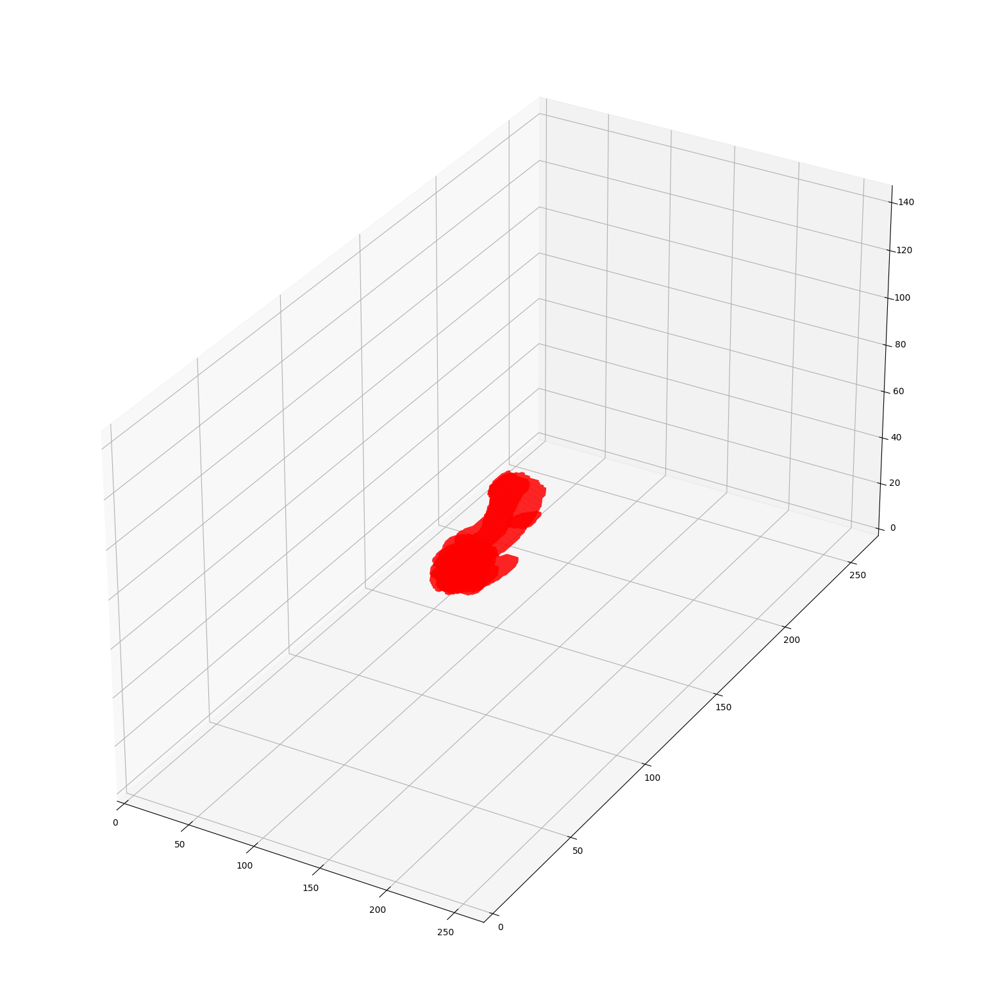

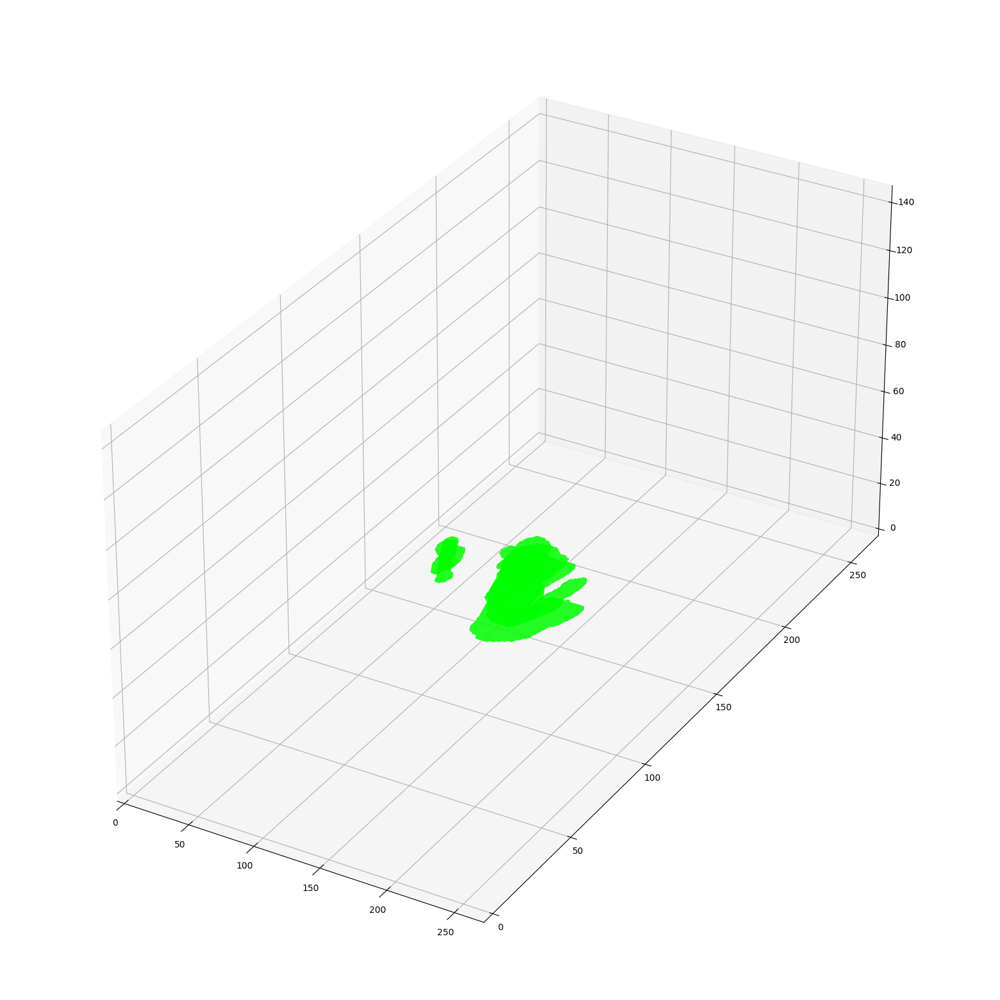

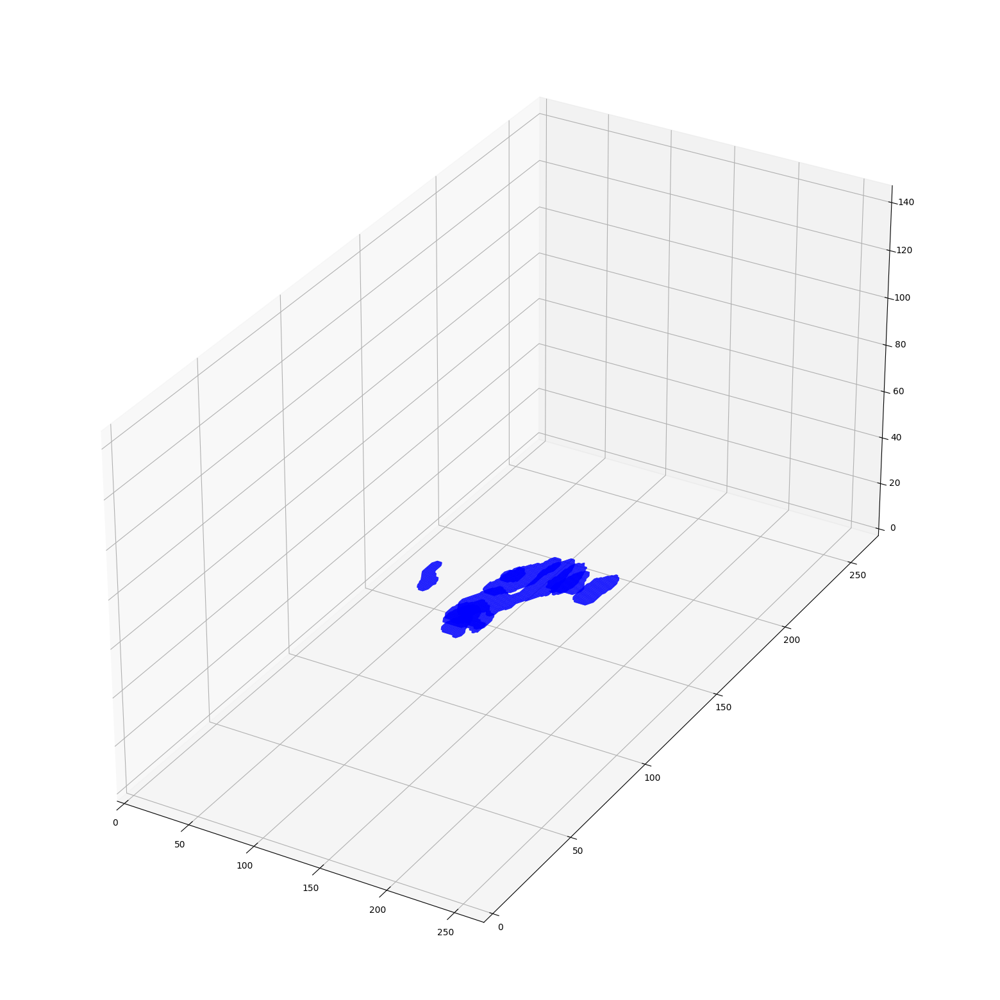

In [9]:
import numpy as np
import os
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage import measure
from PIL import Image

# Function to load images from a given folder
def load_images_from_folder(folder):
    images = []
    if not os.path.exists(folder):
        print("The specified folder does not exist.")
        return images
    for filename in sorted(os.listdir(folder)):
        if filename.endswith('.png'):
            img_path = os.path.join(folder, filename)
            try:
                with Image.open(img_path) as img:
                    images.append(img.copy())
            except IOError:
                print(f"Failed to load {filename}.")
    return images

# Function to extract the color channels into separate 3D volumes
def extract_organ_masks(images):
    organ1_volumes = []
    organ2_volumes = []
    organ3_volumes = []

    for img in images:
        organ1_mask = np.array(img)[:, :, 0]  # Red channel
        organ2_mask = np.array(img)[:, :, 1]  # Green channel
        organ3_mask = np.array(img)[:, :, 2]  # Blue channel

        organ1_volumes.append(organ1_mask)
        organ2_volumes.append(organ2_mask)
        organ3_volumes.append(organ3_mask)
        
    return np.array(organ1_volumes), np.array(organ2_volumes), np.array(organ3_volumes)

# Function to plot a 3D volume using the marching cubes algorithm
def plot_3d(volume, threshold=50, scale_y=1, color=[0.45, 0.45, 0.75]):
    # Position the scan upright and adjust for the specified Y scaling
    p = volume.transpose(2, 1, 0)
    p = p[:, :, ::-1]

    verts, faces, _, _ = measure.marching_cubes(p, threshold)
    fig = plt.figure(figsize=(20, 20))
    ax = fig.add_subplot(111, projection='3d')
    mesh = Poly3DCollection(verts[faces], alpha=0.70)
    mesh.set_facecolor(color)
    ax.add_collection3d(mesh)

    ax.set_box_aspect([1, scale_y, 1])  # Scale the Y-axis
    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])
    plt.show()

# Set the folder where your images are stored
image_folder = '/Users/Tina/Desktop/Resized'  # replace with the path to your image folder
images = load_images_from_folder(image_folder)

if images:
    # Extract the organ masks into separate 3D volumes
    organ1, organ2, organ3 = extract_organ_masks(images)

    # Plot the 3D volume for each organ with different colors
    plot_3d(organ1, threshold=50, scale_y=2, color=[1, 0, 0])  # Red for organ1
    plot_3d(organ2, threshold=50, scale_y=2, color=[0, 1, 0])  # Green for organ2
    plot_3d(organ3, threshold=50, scale_y=2, color=[0, 0, 1])  # Blue for organ3
else:
    print("No images to process.")


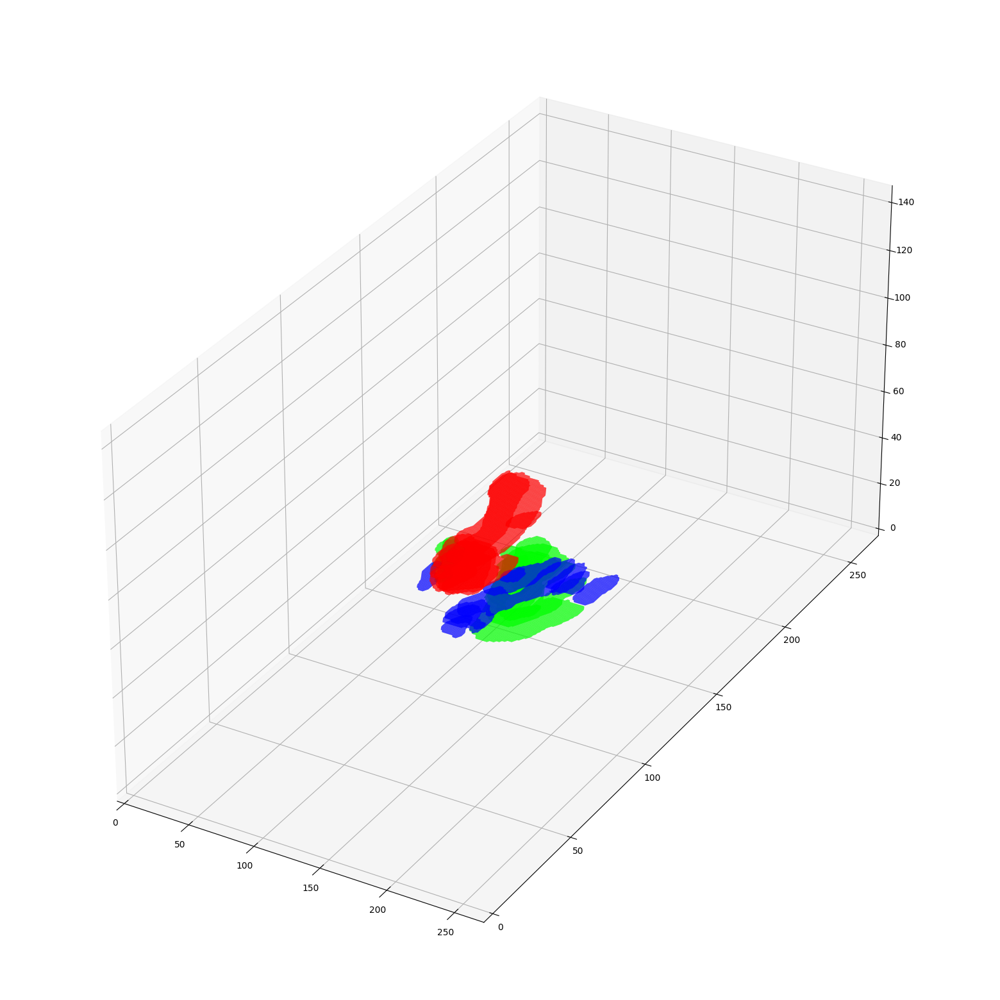

In [10]:
import numpy as np
import os
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage import measure
from PIL import Image

# Function to load images from a given folder
def load_images_from_folder(folder):
    images = []
    if not os.path.exists(folder):
        print("The specified folder does not exist.")
        return images
    for filename in sorted(os.listdir(folder)):
        if filename.endswith('.png'):
            img_path = os.path.join(folder, filename)
            try:
                with Image.open(img_path) as img:
                    images.append(img.copy())
            except IOError:
                print(f"Failed to load {filename}.")
    return images

# Function to extract the color channels into separate 3D volumes
def extract_organ_masks(images):
    organ1_volumes = []
    organ2_volumes = []
    organ3_volumes = []

    for img in images:
        organ1_mask = np.array(img)[:, :, 0]  # Red channel
        organ2_mask = np.array(img)[:, :, 1]  # Green channel
        organ3_mask = np.array(img)[:, :, 2]  # Blue channel

        organ1_volumes.append(organ1_mask)
        organ2_volumes.append(organ2_mask)
        organ3_volumes.append(organ3_mask)
        
    return np.array(organ1_volumes), np.array(organ2_volumes), np.array(organ3_volumes)

# Function to plot multiple 3D volumes
def plot_3d(volumes, threshold=50, scale_y=1, colors=[(1, 0, 0), (0, 1, 0), (0, 0, 1)]):
    fig = plt.figure(figsize=(20, 20))
    ax = fig.add_subplot(111, projection='3d')

    for volume, color in zip(volumes, colors):
        p = volume.transpose(2, 1, 0)
        p = p[:, :, ::-1]
        verts, faces, _, _ = measure.marching_cubes(p, threshold)
        mesh = Poly3DCollection(verts[faces], alpha=0.50)
        mesh.set_facecolor(color)
        ax.add_collection3d(mesh)

    ax.set_box_aspect([1, scale_y, 1])  # Scale the Y-axis
    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])
    plt.show()

# Set the folder where your images are stored
image_folder = '/Users/Tina/Desktop/Resized'  # replace with the path to your image folder
images = load_images_from_folder(image_folder)

if images:
    # Extract the organ masks into separate 3D volumes
    organ1, organ2, organ3 = extract_organ_masks(images)

    # Plot all 3D volumes together with different colors
    plot_3d([organ1, organ2, organ3], threshold=50, scale_y=2)
else:
    print("No images to process.")


In [11]:
import numpy as np
import os
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage import measure
from PIL import Image
import plotly.graph_objects as go

# Function to load images from a given folder
def load_images_from_folder(folder):
    images = []
    if not os.path.exists(folder):
        print("The specified folder does not exist.")
        return images
    for filename in sorted(os.listdir(folder)):
        if filename.endswith('.png'):
            img_path = os.path.join(folder, filename)
            try:
                with Image.open(img_path) as img:
                    images.append(img.copy())
            except IOError:
                print(f"Failed to load {filename}.")
    return images

# Function to extract the color channels into separate 3D volumes
def extract_organ_masks(images,z_spacing=0.1):
    organ1_volumes = []
    organ2_volumes = []
    organ3_volumes = []

    for idx,img in enumerate(images):
        organ1_mask = np.array(img)[:, :, 0]  # Red channel
        organ2_mask = np.array(img)[:, :, 1]  # Green channel
        organ3_mask = np.array(img)[:, :, 2]  # Blue channel

        # Calculate the z-coordinate for the current image
        z_coord = idx * z_spacing

        # Store each image along with its z-coordinate as a tuple
        organ1_volumes.append((organ1_mask, z_coord))
        organ2_volumes.append((organ2_mask, z_coord))
        organ3_volumes.append((organ3_mask, z_coord))
        
    return np.array(organ1_volumes), np.array(organ2_volumes), np.array(organ3_volumes)

def plot_3d_plotly(volumes, threshold=50, scale_y=1, colors=['red', 'green', 'blue']):
    fig = go.Figure()
    for volume, color in zip(volumes, colors):
        p = volume.transpose(2, 1, 0)
        p = p[:, :, ::-1]
        verts, faces, _, _ = measure.marching_cubes(p, threshold)
        x, y, z = zip(*verts)
        
        i, j, k = zip(*faces)
        mesh = go.Mesh3d(x=x, y=y, z=z, i=i, j=j, k=k, color=color, opacity=0.50)
        fig.add_trace(mesh)

    fig.update_layout(
        scene = dict(
            xaxis=dict(nticks=4, range=[0, p.shape[0]],),
            yaxis=dict(nticks=4, range=[0, p.shape[1]*scale_y],),
            zaxis=dict(nticks=4, range=[0, p.shape[2]],),
        ),
        width=700,
        height=700,
        margin=dict(r=10, l=10, b=10, t=10)
    )
    fig.show()


# Set the folder where your images are stored
image_folder = '/Users/Tina/Desktop/Resized'  # replace with the path to your image folder
images = load_images_from_folder(image_folder)

if images:
    # Extract the organ masks into separate 3D volumes
    organ1, organ2, organ3 = extract_organ_masks(images)

    # Plot all 3D volumes together with different colors
    plot_3d_plotly([organ1, organ2, organ3], threshold=50, scale_y=2)
else:
    print("No images to process.")


ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 2 dimensions. The detected shape was (144, 2) + inhomogeneous part.

In [ ]:
!pip install plotly

  Using cached plotly-5.21.0-py3-none-any.whl.metadata (7.1 kB)
  Using cached tenacity-8.2.3-py3-none-any.whl.metadata (1.0 kB)
Using cached plotly-5.21.0-py3-none-any.whl (15.7 MB)
Using cached tenacity-8.2.3-py3-none-any.whl (24 kB)


In [12]:
import numpy as np
import os
import numpy as np
import scipy.ndimage as ndimage  # For smoothing or interpolation
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage import measure
from PIL import Image
import plotly.graph_objects as go
import scipy.ndimage as ndimage  # For smoothing or interpolation

# Function to load images from a given folder
def load_images_from_folder(folder):
    images = []
    if not os.path.exists(folder):
        print("The specified folder does not exist.")
        return images
    for filename in sorted(os.listdir(folder)):
        if filename.endswith('.png'):
            img_path = os.path.join(folder, filename)
            try:
                with Image.open(img_path) as img:
                    images.append(img.copy())
            except IOError:
                print(f"Failed to load {filename}.")
    return images

# Function to extract the color channels into separate 3D volumes
def extract_organ_masks(images):
    organ1_volumes = []
    organ2_volumes = []
    organ3_volumes = []

    for img in images:
        organ1_mask = np.array(img)[:, :, 0]  # Red channel
        organ2_mask = np.array(img)[:, :, 1]  # Green channel
        organ3_mask = np.array(img)[:, :, 2]  # Blue channel

        organ1_volumes.append(organ1_mask)
        organ2_volumes.append(organ2_mask)
        organ3_volumes.append(organ3_mask)
        
    return np.array(organ1_volumes), np.array(organ2_volumes), np.array(organ3_volumes)

def plot_3d_plotly(volumes, threshold=50, scale_y=1, colors=['red', 'green', 'blue']):
    fig = go.Figure()
    for volume, color in zip(volumes, colors):
        # Interpolation or smoothing could be added here if necessary
        # For example, to smooth:
        # volume = ndimage.gaussian_filter(volume, sigma=1)

        p = volume.transpose(2, 1, 0)
        p = p[:, :, ::-1]
        verts, faces, _, _ = measure.marching_cubes(p, threshold)
        x, y, z = zip(*verts)
        
        i, j, k = zip(*faces)
        mesh = go.Mesh3d(x=x, y=y, z=z, i=i, j=j, k=k, color=color, opacity=0.5)
        fig.add_trace(mesh)

    fig.update_layout(
        scene=dict(
            xaxis=dict(nticks=4, range=[0, p.shape[0]],),
            yaxis=dict(nticks=4, range=[0, p.shape[1]*scale_y],),
            zaxis=dict(nticks=4, range=[0, p.shape[2]],),
        ),
        width=700,
        height=700,
        margin=dict(r=10, l=10, b=10, t=10)
    )
    fig.show()


# Set the folder where your images are stored
image_folder = '/Users/Tina/Desktop/Resized'  # replace with the path to your image folder
images = load_images_from_folder(image_folder)

if images:
    # Extract the organ masks into separate 3D volumes
    organ1, organ2, organ3 = extract_organ_masks(images)

    # Plot all 3D volumes together with different colors
    plot_3d_plotly([organ1, organ2, organ3], threshold=50, scale_y=2)
else:
    print("No images to process.")


# Create 3D Model out of all 3 organs

In [13]:
import numpy as np
import os
from skimage import measure
from PIL import Image
import plotly.graph_objects as go
from scipy.ndimage import zoom, binary_closing
from skimage.morphology import ball

# Function to load images from a given folder
def load_images_from_folder(folder):
    images = []
    if not os.path.exists(folder):
        print("The specified folder does not exist.")
        return images
    for filename in sorted(os.listdir(folder)):
        if filename.endswith('.png'):
            img_path = os.path.join(folder, filename)
            try:
                with Image.open(img_path) as img:
                    images.append(np.array(img))
            except IOError:
                print(f"Failed to load {filename}.")
    return images

# Function to extract the color channels into separate 3D volumes
def extract_organ_masks(images):
    organ_volumes = [np.zeros_like(images[0][:, :, 0]) for _ in range(3)]
    for img in images:
        for i in range(3):
            organ_volumes[i] = np.dstack((organ_volumes[i], img[:, :, i]))
    return organ_volumes

# Function to interpolate volumes
def interpolate_volumes(volumes, scale_factor):
    return [zoom(volume, (1, 1, scale_factor), order=3) for volume in volumes]

# Function to apply morphological closing to volumes
def close_volumes(volumes, size=2):
    structure = ball(size)
    return [binary_closing(volume, structure=structure) for volume in volumes]

# Function to plot 3D volumes using plotly
def plot_3d_plotly(volumes, colors=['red', 'green', 'blue']):
    fig = go.Figure()
    for volume, color in zip(volumes, colors):
        # Find the range of the volume data
        vol_min, vol_max = np.min(volume), np.max(volume)
        print(f"Volume Data Range for color {color}: {vol_min} to {vol_max}")
        
        # Set threshold to be a percentage of the max value, e.g., halfway
        threshold = vol_max * 0.5
        
        # Ensure data type is appropriate for marching cubes
        volume = volume.astype(np.float32)
        volume = volume[:, :, ::-1]
    
        # Run marching cubes algorithm
        verts, faces, normals, values = measure.marching_cubes(volume, threshold)
        
        x, y, z = zip(*verts)

        i, j, k = zip(*faces)
        mesh = go.Mesh3d(
            x=x, y=y, z=z, i=i, j=j, k=k, 
            color=color, 
            opacity=0.5, 
            name=f'Organ {color}'
        )
        fig.add_trace(mesh)

    fig.update_layout(
        scene=dict(
            xaxis=dict(nticks=4, range=[0, np.shape(volumes[0])[0]]),
            yaxis=dict(nticks=4, range=[0, np.shape(volumes[0])[1]]),
            zaxis=dict(nticks=4, range=[0,np.shape(volumes[0])[2]]),
        ),
        width=700,
        height=700,
        margin=dict(r=10, l=10, b=10, t=10)
    )
    fig.show()


# Path to your image folder
image_folder = '/Users/Tina/Desktop/Resized'  # Replace with the path to your image folder

# Load images, extract organ masks, interpolate, apply closing, and plot
images = load_images_from_folder(image_folder)

if images:
    organ_volumes = extract_organ_masks(images)
    organ_volumes = interpolate_volumes(organ_volumes, scale_factor=2)  # Change scale_factor as needed
    organ_volumes = close_volumes(organ_volumes, size=2)  # Adjust size as needed for closing
    plot_3d_plotly(organ_volumes)
else:
    print("No images to process.")


Volume Data Range for color red: False to True
Volume Data Range for color green: False to True
Volume Data Range for color blue: False to True


# Save each organ as one 3D Model and plot them together

In [34]:
import numpy as np
import os
from skimage import measure
from PIL import Image
import plotly.graph_objects as go
from scipy.ndimage import zoom, binary_closing
from skimage.morphology import ball

# Function to load images from a given folder
def load_images_from_folder(folder):
    images = []
    if not os.path.exists(folder):
        print("The specified folder does not exist.")
        return images
    for filename in sorted(os.listdir(folder)):
        if filename.endswith('.png'):
            img_path = os.path.join(folder, filename)
            try:
                with Image.open(img_path) as img:
                    images.append(np.array(img))
            except IOError:
                print(f"Failed to load {filename}.")
    return images

# Function to extract the color channels into separate 3D volumes
def extract_organ_masks(images):
    organ_volumes = [np.zeros_like(images[0][:, :, 0]) for _ in range(3)]
    for img in images:
        for i in range(3):
            organ_volumes[i] = np.dstack((organ_volumes[i], img[:, :, i]))
    return organ_volumes

# Function to interpolate volumes
def interpolate_volumes(volumes, scale_factor):
    return [zoom(volume, (1, 1, scale_factor), order=3) for volume in volumes]

# Function to apply morphological closing to volumes
def close_volumes(volumes, size=2):
    structure = ball(size)
    return [binary_closing(volume, structure=structure) for volume in volumes]

# Function to plot 3D volumes using plotly
def plot_3d_plotly(vertices_list, faces_list, colors=['red', 'green', 'blue']):
    fig = go.Figure()
    for vertices, faces, color in zip(vertices_list, faces_list, colors):
        x, y, z = zip(*vertices)
        i, j, k = zip(*faces)
        mesh = go.Mesh3d(
            x=x, y=y, z=z, i=i, j=j, k=k, 
            color=color, 
            opacity=0.5, 
            name=f'Organ {color}'
        )
        fig.add_trace(mesh)

    fig.update_layout(
        scene=dict(
            xaxis=dict(nticks=4),
            yaxis=dict(nticks=4),
            zaxis=dict(nticks=4),
        ),
        width=700,
        height=700,
        margin=dict(r=10, l=10, b=10, t=10)
    )
    fig.show()


# Path to your image folder
image_folder = '/Users/Tina/Desktop/Resized'  # Replace with the path to your image folder

# Load images, extract organ masks, interpolate, apply closing, and plot
images = load_images_from_folder(image_folder)

if images:
    organ_volumes = extract_organ_masks(images)
    organ_volumes = interpolate_volumes(organ_volumes, scale_factor=2)  # Change scale_factor as needed
    organ_volumes = close_volumes(organ_volumes, size=2)  # Adjust size as needed for closing
    
    # Extract vertices and faces for each organ separately
    vertices_list = []
    faces_list = []
    for volume in organ_volumes:
        threshold = np.max(volume) * 0.5
        volume = volume.astype(np.float32)
        volume = volume[:, :, ::-1]
        verts, faces, _, _ = measure.marching_cubes(volume, threshold)
        vertices_list.append(verts)
        faces_list.append(faces)
    
    plot_3d_plotly(vertices_list, faces_list)
else:
    print("No images to process.")


# Make 3D Model of each organ and save as .obj 

In [17]:
# Function to save vertices and faces to an .obj file
def save_as_obj(filename, vertices, faces):
    with open(filename, 'w') as f:
        # Write vertices
        for v in vertices:
            f.write(f'v {v[0]} {v[1]} {v[2]}\n')

        # Write faces
        for face in faces:
            f.write(f'f {" ".join(str(i+1) for i in face)}\n')

# Function to extract vertices and faces for each organ separately
def extract_mesh_from_volumes(volumes):
    vertices_list = []
    faces_list = []
    for volume in volumes:
        threshold = np.max(volume) * 0.5
        volume = volume.astype(np.float32)
        volume = volume[:, :, ::-1]
        verts, faces, _, _ = measure.marching_cubes(volume, threshold)
        vertices_list.append(verts)
        faces_list.append(faces)
    return vertices_list, faces_list

# Path to save the separate organ .obj files
output_folder = '/Users/Tina/Desktop/obj/'

# Load images, extract organ masks, interpolate, apply closing, and plot
images = load_images_from_folder(image_folder)

if images:
    organ_volumes = extract_organ_masks(images)
    organ_volumes = interpolate_volumes(organ_volumes, scale_factor=2)  # Change scale_factor as needed
    organ_volumes = close_volumes(organ_volumes, size=2)  # Adjust size as needed for closing

    # Extract vertices and faces for each organ separately
    vertices_list, faces_list = extract_mesh_from_volumes(organ_volumes)

    # Save each organ as a separate .obj file
    for i, (vertices, faces) in enumerate(zip(vertices_list, faces_list)):
        organ_filename = os.path.join(output_folder, f'organ_{i}.obj')
        save_as_obj(organ_filename, vertices, faces)
        print(f"Organ {i} saved as {organ_filename}")

else:
    print("No images to process.")


Organ 0 saved as /Users/Tina/Desktop/obj/organ_0.obj
Organ 1 saved as /Users/Tina/Desktop/obj/organ_1.obj
Organ 2 saved as /Users/Tina/Desktop/obj/organ_2.obj


# each organ and combined but not stringed combined model

In [18]:
# Function to save vertices and faces to an .obj file
def save_as_obj(filename, vertices, faces):
    with open(filename, 'w') as f:
        # Write vertices
        for v in vertices:
            f.write(f'v {v[0]} {v[1]} {v[2]}\n')

        # Write faces
        for face in faces:
            f.write(f'f {" ".join(str(i+1) for i in face)}\n')

# Function to extract vertices and faces for each organ separately
def extract_mesh_from_volumes(volumes):
    vertices_list = []
    faces_list = []
    for volume in volumes:
        threshold = np.max(volume) * 0.5
        volume = volume.astype(np.float32)
        volume = volume[:, :, ::-1]
        verts, faces, _, _ = measure.marching_cubes(volume, threshold)
        vertices_list.append(verts)
        faces_list.append(faces)
    return vertices_list, faces_list

# Path to save the separate organ .obj files
output_folder = '/Users/Tina/Desktop/obj/'

# Load images, extract organ masks, interpolate, apply closing, and plot
images = load_images_from_folder(image_folder)

if images:
    organ_volumes = extract_organ_masks(images)
    organ_volumes = interpolate_volumes(organ_volumes, scale_factor=2)  # Change scale_factor as needed
    organ_volumes = close_volumes(organ_volumes, size=2)  # Adjust size as needed for closing

    # Extract vertices and faces for each organ separately
    vertices_list, faces_list = extract_mesh_from_volumes(organ_volumes)

    # Save each organ as a separate .obj file
    for i, (vertices, faces) in enumerate(zip(vertices_list, faces_list)):
        organ_filename = os.path.join(output_folder, f'organ_{i}.obj')
        save_as_obj(organ_filename, vertices, faces)
        print(f"Organ {i} saved as {organ_filename}")

    # Combine all organ .obj files into a single .obj file
    combined_filename = os.path.join(output_folder, 'combined_model.obj')
    with open(combined_filename, 'w') as combined_file:
        for i in range(len(vertices_list)):
            organ_filename = os.path.join(output_folder, f'organ_{i}.obj')
            with open(organ_filename, 'r') as organ_file:
                combined_file.write(organ_file.read())
        print(f"Combined model saved as {combined_filename}")

else:
    print("No images to process.")


Organ 0 saved as /Users/Tina/Desktop/obj/organ_0.obj
Organ 1 saved as /Users/Tina/Desktop/obj/organ_1.obj
Organ 2 saved as /Users/Tina/Desktop/obj/organ_2.obj
Combined model saved as /Users/Tina/Desktop/obj/combined_model.obj


# Exports 3D Model, no geometry data, does not work

In [28]:
import os
import numpy as np
from skimage import measure
def save_as_obj(filename, organ_vertices_list, organ_faces_list):
    with open(filename, 'w') as f:
        vertex_offset = 0  # Keeps track of the index offset for vertices between different organs
        for organ_idx, (vertices, faces) in enumerate(zip(organ_vertices_list, organ_faces_list), start=1):
            if len(vertices) == 0 or len(faces) == 0:
                print(f"No geometric data for Organ{organ_idx} (Vertices: {len(vertices)}, Faces: {len(faces)})")
                continue
            f.write(f'g Organ{organ_idx}\n')
            for v in vertices:
                f.write(f'v {v[0]} {v[1]} {v[2]}\n')
            adjusted_faces = [[idx + vertex_offset for idx in face] for face in faces]
            for face in adjusted_faces:
                f.write(f'f {" ".join(map(str, face))}\n')
            vertex_offset += len(vertices)
        if vertex_offset == 0:
            print("Warning: No vertices written to file.")
def extract_mesh_from_volumes(volumes):
    vertices_list = []
    faces_list = []
    for volume in volumes:
        threshold = np.max(volume) * 0.5
        verts, faces, _, _ = measure.marching_cubes(volume, threshold)
        vertices_list.append(verts)
        faces_list.append(faces)
        print(f"Extracted mesh for volume (Vertices: {len(verts)}, Faces: {len(faces)})")
    return vertices_list, faces_list
output_folder = '/Users/Tina/Desktop/obj/'
combined_filename = os.path.join(output_folder, 'combined_organs3.obj')
images = load_images_from_folder(image_folder)
if images:
    organ_volumes = extract_organ_masks(images)
    organ_volumes = interpolate_volumes(organ_volumes, scale_factor=2)
    organ_volumes = close_volumes(organ_volumes, size=2)
    vertices_list, faces_list = extract_mesh_from_volumes(organ_volumes)
    save_as_obj(combined_filename, vertices_list, faces_list)
    print(f"All organs saved as {combined_filename}")
else:
    print("No images to process.")


Extracted mesh for volume (Vertices: 21728, Faces: 43472)
Extracted mesh for volume (Vertices: 53234, Faces: 106520)
Extracted mesh for volume (Vertices: 36708, Faces: 73476)
All organs saved as /Users/Tina/Desktop/obj/combined_organs3.obj


# Exports 3D Model, no geometry data, does not work

In [33]:
import os
import numpy as np
from skimage import measure
def save_as_obj(filename, organ_vertices_list, organ_faces_list):
    with open(filename, 'w') as f:
        vertex_offset = 0
        for organ_idx, (vertices, faces) in enumerate(zip(organ_vertices_list, organ_faces_list), start=1):
            if len(vertices) == 0 or len(faces) == 0:
                print(f"No geometric data for Organ{organ_idx} (Vertices: {len(vertices)}, Faces: {len(faces)})")
                continue
            f.write(f'g Organ{organ_idx}\n')
            for v in vertices:
                f.write(f'v {v[0]} {v[1]} {v[2]}\n')
            adjusted_faces = [[idx + vertex_offset for idx in face] for face in faces]
            for face in adjusted_faces:
                if len(face) != 3:
                    print(f"Skipping invalid face with {len(face)} vertices.")
                    continue
                f.write(f'f {" ".join(map(str, face))}\n')
            vertex_offset += len(vertices)
def extract_mesh_from_volumes(volumes):
    vertices_list = []
    faces_list = []
    for volume in volumes:
        threshold = np.max(volume) * 0.5
        verts, faces, _, _ = measure.marching_cubes(volume, threshold)
        print(f"Extracted mesh for volume (Vertices: {len(verts)}, Faces: {len(faces)})")
        vertices_list.append(verts)
        faces_list.append(faces)
    return vertices_list, faces_list
output_folder = '/Users/Tina/Desktop/obj/'
combined_filename = os.path.join(output_folder, 'combined_organs4.obj')
images = load_images_from_folder(image_folder)
if images:
    organ_volumes = extract_organ_masks(images)
    organ_volumes = interpolate_volumes(organ_volumes, scale_factor=2)
    organ_volumes = close_volumes(organ_volumes, size=2)
    vertices_list, faces_list = extract_mesh_from_volumes(organ_volumes)
    save_as_obj(combined_filename, vertices_list, faces_list)
    print(f"All organs saved as {combined_filename}")
else:
    print("No images to process.")


Extracted mesh for volume (Vertices: 24897, Faces: 50074)
Extracted mesh for volume (Vertices: 59683, Faces: 119962)
Extracted mesh for volume (Vertices: 41369, Faces: 83126)
All organs saved as /Users/Tina/Desktop/obj/combined_organs4.obj


# Working Model to extract 3D Model with all organs, still upsite down

In [36]:
import os
import numpy as np
from skimage import measure

def is_valid_mesh(vertices, faces):
    if len(vertices) == 0 or len(faces) == 0:
        return False
    for face in faces:
        if len(face) != 3:
            return False
        for idx in face:
            if idx < 0 or idx >= len(vertices):
                return False
    return True

def save_as_obj(filename, organ_vertices_list, organ_faces_list):
    with open(filename, 'w') as f:
        vertex_offset = 1  # Start indexing vertices from 1
        for organ_idx, (vertices, faces) in enumerate(zip(organ_vertices_list, organ_faces_list), start=1):
            if not is_valid_mesh(vertices, faces):
                print(f"Invalid mesh data for Organ{organ_idx}. Skipping save.")
                continue
            f.write(f'g Organ{organ_idx}\n')
            for v in vertices:
                f.write(f'v {v[0]} {v[1]} {v[2]}\n')
            adjusted_faces = [[idx + vertex_offset for idx in face] for face in faces]
            for face in adjusted_faces:
                if len(face) != 3:
                    print(f"Skipping invalid face with {len(face)} vertices.")
                    continue
                f.write(f'f {" ".join(map(str, face))}\n')
            vertex_offset += len(vertices)


def extract_mesh_from_volumes(volumes):
    vertices_list = []
    faces_list = []
    for volume in volumes:
        threshold = np.max(volume) * 0.5
        verts, faces, _, _ = measure.marching_cubes(volume, threshold)
        print(f"Extracted mesh for volume (Vertices: {len(verts)}, Faces: {len(faces)})")
        vertices_list.append(verts)
        faces_list.append(faces)
    return vertices_list, faces_list

output_folder = '/Users/Tina/Desktop/obj/'
combined_filename = os.path.join(output_folder, 'combined_organs5.obj')

# Assuming load_images_from_folder and extract_organ_masks are defined elsewhere
# Define these functions or replace them with actual implementations

# Check if images exist
if images:
    organ_volumes = extract_organ_masks(images)
    organ_volumes = interpolate_volumes(organ_volumes, scale_factor=2)
    organ_volumes = close_volumes(organ_volumes, size=2)
    vertices_list, faces_list = extract_mesh_from_volumes(organ_volumes)
    save_as_obj(combined_filename, vertices_list, faces_list)
    print(f"All organs saved as {combined_filename}")
else:
    print("No images to process.")


Extracted mesh for volume (Vertices: 21728, Faces: 43472)
Extracted mesh for volume (Vertices: 53234, Faces: 106520)
Extracted mesh for volume (Vertices: 36708, Faces: 73476)
All organs saved as /Users/Tina/Desktop/obj/combined_organs5.obj


# Working Model to extract 3D Model with all organs, no color

In [41]:
import os
import numpy as np
from skimage import measure

def is_valid_mesh(vertices, faces):
    if len(vertices) == 0 or len(faces) == 0:
        return False
    for face in faces:
        if len(face) != 3:
            return False
        for idx in face:
            if idx < 0 or idx >= len(vertices):
                return False
    return True

def save_as_obj(filename, organ_vertices_list, organ_faces_list):
    with open(filename, 'w') as f:
        vertex_offset = 1  # Start indexing vertices from 1
        for organ_idx, (vertices, faces) in enumerate(zip(organ_vertices_list, organ_faces_list), start=1):
            if not is_valid_mesh(vertices, faces):
                print(f"Invalid mesh data for Organ{organ_idx}. Skipping save.")
                continue
            f.write(f'g Organ{organ_idx}\n')
            for v in vertices:
                f.write(f'v {v[0]} {v[1]} {v[2]}\n')
            adjusted_faces = [[idx + vertex_offset for idx in face] for face in faces]
            for face in adjusted_faces:
                if len(face) != 3:
                    print(f"Skipping invalid face with {len(face)} vertices.")
                    continue
                f.write(f'f {" ".join(map(str, face))}\n')
            vertex_offset += len(vertices)


def extract_mesh_from_volumes(volumes):
    vertices_list = []
    faces_list = []
    for volume in volumes:
        threshold = np.max(volume) * 0.5
        volume = volume[:, :, ::-1]  # Optional: Adjust coordinate system if necessary
        verts, faces, _, _ = measure.marching_cubes(volume, threshold)
        print(f"Extracted mesh for volume (Vertices: {len(verts)}, Faces: {len(faces)})")
        vertices_list.append(verts)
        faces_list.append(faces)
    return vertices_list, faces_list

output_folder = '/Users/Tina/Desktop/obj/'
combined_filename = os.path.join(output_folder, 'combined_organs5.obj')

# Assuming load_images_from_folder and extract_organ_masks are defined elsewhere
# Define these functions or replace them with actual implementations

# Check if images exist
if images:
    organ_volumes = extract_organ_masks(images)
    organ_volumes = interpolate_volumes(organ_volumes, scale_factor=2)
    organ_volumes = close_volumes(organ_volumes, size=2)
    vertices_list, faces_list = extract_mesh_from_volumes(organ_volumes)
    save_as_obj(combined_filename, vertices_list, faces_list)
    print(f"All organs saved as {combined_filename}")
else:
    print("No images to process.")


Extracted mesh for volume (Vertices: 21728, Faces: 43472)
Extracted mesh for volume (Vertices: 53234, Faces: 106520)
Extracted mesh for volume (Vertices: 36708, Faces: 73476)
All organs saved as /Users/Tina/Desktop/obj/combined_organs5.obj


#With color?

In [40]:
import os
import numpy as np
from skimage import measure

def is_valid_mesh(vertices, faces):
    if len(vertices) == 0 or len(faces) == 0:
        return False
    for face in faces:
        if len(face) != 3:
            return False
        for idx in face:
            if idx < 0 or idx >= len(vertices):
                return False
    return True

def save_as_obj(filename, organ_vertices_list, organ_faces_list, organ_colors_list=None):
    with open(filename, 'w') as f:
        vertex_offset = 1  # Start indexing vertices from 1
        for organ_idx, (vertices, faces) in enumerate(zip(organ_vertices_list, organ_faces_list), start=1):
            if not is_valid_mesh(vertices, faces):
                print(f"Invalid mesh data for Organ{organ_idx}. Skipping save.")
                continue
            f.write(f'g Organ{organ_idx}\n')
            if organ_colors_list is not None and len(organ_colors_list) >= organ_idx:
                organ_colors = organ_colors_list[organ_idx - 1]
                for v, c in zip(vertices, organ_colors):
                    f.write(f'v {v[0]} {v[1]} {v[2]} {c[0]} {c[1]} {c[2]}\n')
            else:
                for v in vertices:
                    f.write(f'v {v[0]} {v[1]} {v[2]}\n')
            adjusted_faces = [[idx + vertex_offset for idx in face] for face in faces]
            for face in adjusted_faces:
                if len(face) != 3:
                    print(f"Skipping invalid face with {len(face)} vertices.")
                    continue
                f.write(f'f {" ".join(map(str, face))}\n')
            vertex_offset += len(vertices)

def extract_mesh_from_volumes(volumes):
    vertices_list = []
    faces_list = []
    for volume in volumes:
        threshold = np.max(volume) * 0.5
        volume = volume[:, :, ::-1]  # Optional: Adjust coordinate system if necessary
        verts, faces, _, _ = measure.marching_cubes(volume, threshold)
        print(f"Extracted mesh for volume (Vertices: {len(verts)}, Faces: {len(faces)})")
        vertices_list.append(verts)
        faces_list.append(faces)
    return vertices_list, faces_list

output_folder = '/Users/Tina/Desktop/obj/'
combined_filename = os.path.join(output_folder, 'combined_organs6.obj')

# Define a function to generate random colors
def generate_random_colors(num_colors):
    return np.random.rand(num_colors, 3)

# Assuming load_images_from_folder and extract_organ_masks are defined elsewhere
# Define these functions or replace them with actual implementations

# Check if images exist
if images:
    organ_volumes = extract_organ_masks(images)
    organ_volumes = interpolate_volumes(organ_volumes, scale_factor=2)
    organ_volumes = close_volumes(organ_volumes, size=2)
    
    # Generate random colors for each organ
    num_organs = len(organ_volumes)
    organ_colors = generate_random_colors(num_organs)
    
    vertices_list, faces_list = extract_mesh_from_volumes(organ_volumes)
    save_as_obj(combined_filename, vertices_list, faces_list, organ_colors_list=[organ_colors])
    print(f"All organs saved as {combined_filename}")
else:
    print("No images to process.")


Extracted mesh for volume (Vertices: 21728, Faces: 43472)
Extracted mesh for volume (Vertices: 53234, Faces: 106520)
Extracted mesh for volume (Vertices: 36708, Faces: 73476)
All organs saved as /Users/Tina/Desktop/obj/combined_organs6.obj
